# Download Thread

In [1]:
import os
import requests
from urllib.parse import urljoin
from threading import Thread, Lock

from bs4 import BeautifulSoup

# Global lock to prevent race conditions when printing
print_lock = Lock()

def download_file(file_url, output_file):
    try:
        if os.path.exists(output_file):
            with print_lock:
                print(f"Skipping {output_file} as it already exists")
            return
        with open(output_file, 'wb') as f:
            response = requests.get(file_url, timeout=100)  # Adjust timeout as needed
            f.write(response.content)
        with print_lock:
            print(f"Downloaded {output_file}")
    except Exception as e:
        with print_lock:
            print(f"Error downloading {output_file}: {e}")

def download_files(directory_url, output_folder):
    # Create the output folder if it doesn't exist
    if not os.path.exists(output_folder):
        os.makedirs(output_folder)

    # List to hold threads
    threads = []

    # Loop through the directories and files based on the structure described
    for p_folder in range(1):  # p00 to p10
        p_folder_str = f"p{p_folder:02d}"
        p_folder_path = os.path.join(output_folder, p_folder_str)
        if not os.path.exists(p_folder_path):
            os.makedirs(p_folder_path)
        for p_subfolder in range(1000):  # p0000 to p0999
            p_subfolder_str = f"p{p_subfolder:05d}"
            p_subfolder_path = os.path.join(p_folder_path, p_subfolder_str)
            if not os.path.exists(p_subfolder_path):
                os.makedirs(p_subfolder_path)
            for s_segment in range(50):  # s00 to s49
                s_segment_str = f"s{s_segment:02d}"

                # Construct file names
                atr_file = f"{p_folder_str}/{p_subfolder_str}/{p_subfolder_str}_{s_segment_str}.atr"
                dat_file = f"{p_folder_str}/{p_subfolder_str}/{p_subfolder_str}_{s_segment_str}.dat"
                hea_file = f"{p_folder_str}/{p_subfolder_str}/{p_subfolder_str}_{s_segment_str}.hea"

                # Construct download paths
                atr_url = urljoin(directory_url, atr_file)
                dat_url = urljoin(directory_url, dat_file)
                hea_url = urljoin(directory_url, hea_file)

                # Create threads for downloading each file
                atr_thread = Thread(target=download_file, args=(atr_url, os.path.join(output_folder, atr_file)))
                dat_thread = Thread(target=download_file, args=(dat_url, os.path.join(output_folder, dat_file)))
                hea_thread = Thread(target=download_file, args=(hea_url, os.path.join(output_folder, hea_file)))

                # Start the threads
                atr_thread.start()
                dat_thread.start()
                hea_thread.start()

                # Add threads to the list
                threads.extend([atr_thread, dat_thread, hea_thread])

    # Wait for all threads to complete
    for thread in threads:
        thread.join()

url = 'https://physionet.org/files/icentia11k-continuous-ecg/1.0/'
output_folder = 'C:/Users/andre/1JUPYTER/IC/ecg_data/4_icentia11k/data'

download_files(url, output_folder)

Skipping C:/Users/andre/1JUPYTER/IC/ecg_data/4_icentia11k/data\p00/p00000/p00000_s00.atr as it already exists
Skipping C:/Users/andre/1JUPYTER/IC/ecg_data/4_icentia11k/data\p00/p00000/p00000_s00.dat as it already exists
Skipping C:/Users/andre/1JUPYTER/IC/ecg_data/4_icentia11k/data\p00/p00000/p00000_s00.hea as it already exists
Skipping C:/Users/andre/1JUPYTER/IC/ecg_data/4_icentia11k/data\p00/p00000/p00000_s01.atr as it already exists
Skipping C:/Users/andre/1JUPYTER/IC/ecg_data/4_icentia11k/data\p00/p00000/p00000_s01.dat as it already exists
Skipping C:/Users/andre/1JUPYTER/IC/ecg_data/4_icentia11k/data\p00/p00000/p00000_s01.hea as it already exists
Skipping C:/Users/andre/1JUPYTER/IC/ecg_data/4_icentia11k/data\p00/p00000/p00000_s02.atr as it already exists
Skipping C:/Users/andre/1JUPYTER/IC/ecg_data/4_icentia11k/data\p00/p00000/p00000_s02.dat as it already exists
Skipping C:/Users/andre/1JUPYTER/IC/ecg_data/4_icentia11k/data\p00/p00000/p00000_s02.hea as it already exists
Skipping C

KeyboardInterrupt: 

Error downloading C:/Users/andre/1JUPYTER/IC/ecg_data/4_icentia11k/data\p00/p00903/p00903_s34.atr: HTTPSConnectionPool(host='physionet.org', port=443): Max retries exceeded with url: /files/icentia11k-continuous-ecg/1.0/p00/p00903/p00903_s34.atr (Caused by ConnectTimeoutError(<urllib3.connection.HTTPSConnection object at 0x000001867E00C2D0>, 'Connection to physionet.org timed out. (connect timeout=100)'))
Error downloading C:/Users/andre/1JUPYTER/IC/ecg_data/4_icentia11k/data\p00/p00903/p00903_s05.dat: HTTPSConnectionPool(host='physionet.org', port=443): Max retries exceeded with url: /files/icentia11k-continuous-ecg/1.0/p00/p00903/p00903_s05.dat (Caused by ConnectTimeoutError(<urllib3.connection.HTTPSConnection object at 0x000001867C87B010>, 'Connection to physionet.org timed out. (connect timeout=100)'))
Error downloading C:/Users/andre/1JUPYTER/IC/ecg_data/4_icentia11k/data\p00/p00903/p00903_s32.dat: HTTPSConnectionPool(host='physionet.org', port=443): Max retries exceeded with url:

Error downloading C:/Users/andre/1JUPYTER/IC/ecg_data/4_icentia11k/data\p00/p00903/p00903_s36.hea: HTTPSConnectionPool(host='physionet.org', port=443): Max retries exceeded with url: /files/icentia11k-continuous-ecg/1.0/p00/p00903/p00903_s36.hea (Caused by ConnectTimeoutError(<urllib3.connection.HTTPSConnection object at 0x000001867E02D550>, 'Connection to physionet.org timed out. (connect timeout=100)'))
Error downloading C:/Users/andre/1JUPYTER/IC/ecg_data/4_icentia11k/data\p00/p00903/p00903_s30.atr: HTTPSConnectionPool(host='physionet.org', port=443): Max retries exceeded with url: /files/icentia11k-continuous-ecg/1.0/p00/p00903/p00903_s30.atr (Caused by ConnectTimeoutError(<urllib3.connection.HTTPSConnection object at 0x000001867CCD6E50>, 'Connection to physionet.org timed out. (connect timeout=100)'))
Error downloading C:/Users/andre/1JUPYTER/IC/ecg_data/4_icentia11k/data\p00/p00903/p00903_s35.atr: HTTPSConnectionPool(host='physionet.org', port=443): Max retries exceeded with url:

# Download Simple

In [2]:
import os
import requests
from urllib.parse import urljoin
from threading import Thread, Lock

from bs4 import BeautifulSoup

# Global lock to prevent race conditions when printing
print_lock = Lock()

def download_file(file_url, output_file):
    if os.path.exists(output_file):
        with print_lock:
            print(f"Skipping {output_file} as it already exists")
        return
    with open(output_file, 'wb') as f:
        f.write(requests.get(file_url).content)
    with print_lock:
        print(f"Downloaded {output_file}")

def download_files(directory_url, output_folder):
    # Create the output folder if it doesn't exist
    if not os.path.exists(output_folder):
        os.makedirs(output_folder)

    # Loop through the directories and files based on the structure described
    for p_folder in range(1):  # p00 to p10
        p_folder_str = f"p{p_folder:02d}"
        p_folder_path = os.path.join(output_folder, p_folder_str)
        if not os.path.exists(p_folder_path):
            os.makedirs(p_folder_path)
        for p_subfolder in range(1000):  # p0000 to p0999
            p_subfolder_str = f"p{p_subfolder:05d}"
            p_subfolder_path = os.path.join(p_folder_path, p_subfolder_str)
            if not os.path.exists(p_subfolder_path):
                os.makedirs(p_subfolder_path)
            for s_segment in range(50):  # s00 to s49
                s_segment_str = f"s{s_segment:02d}"

                # Construct file names
                atr_file = f"{p_folder_str}/{p_subfolder_str}/{p_subfolder_str}_{s_segment_str}.atr"
                dat_file = f"{p_folder_str}/{p_subfolder_str}/{p_subfolder_str}_{s_segment_str}.dat"
                hea_file = f"{p_folder_str}/{p_subfolder_str}/{p_subfolder_str}_{s_segment_str}.hea"

                # Construct download paths
                atr_url = urljoin(directory_url, atr_file)
                dat_url = urljoin(directory_url, dat_file)
                hea_url = urljoin(directory_url, hea_file)

                # Download the files
                download_file(atr_url, os.path.join(output_folder, atr_file))
                download_file(dat_url, os.path.join(output_folder, dat_file))
                download_file(hea_url, os.path.join(output_folder, hea_file))

url = 'https://physionet.org/files/icentia11k-continuous-ecg/1.0/'
output_folder = 'C:/Users/andre/1JUPYTER/IC/ecg_data/4_icentia11k/data'

download_files(url, output_folder)

Skipping C:/Users/andre/1JUPYTER/IC/ecg_data/4_icentia11k/data\p00/p00000/p00000_s00.atr as it already exists
Skipping C:/Users/andre/1JUPYTER/IC/ecg_data/4_icentia11k/data\p00/p00000/p00000_s00.dat as it already exists
Skipping C:/Users/andre/1JUPYTER/IC/ecg_data/4_icentia11k/data\p00/p00000/p00000_s00.hea as it already exists
Skipping C:/Users/andre/1JUPYTER/IC/ecg_data/4_icentia11k/data\p00/p00000/p00000_s01.atr as it already exists
Skipping C:/Users/andre/1JUPYTER/IC/ecg_data/4_icentia11k/data\p00/p00000/p00000_s01.dat as it already exists
Skipping C:/Users/andre/1JUPYTER/IC/ecg_data/4_icentia11k/data\p00/p00000/p00000_s01.hea as it already exists
Skipping C:/Users/andre/1JUPYTER/IC/ecg_data/4_icentia11k/data\p00/p00000/p00000_s02.atr as it already exists
Skipping C:/Users/andre/1JUPYTER/IC/ecg_data/4_icentia11k/data\p00/p00000/p00000_s02.dat as it already exists
Skipping C:/Users/andre/1JUPYTER/IC/ecg_data/4_icentia11k/data\p00/p00000/p00000_s02.hea as it already exists
Skipping C

In [ ]:
import os
import requests
from urllib.parse import urljoin
from threading import Thread, Lock

from bs4 import BeautifulSoup

# Global lock to prevent race conditions when printing
print_lock = Lock()

def download_file(file_url, output_file):
    if os.path.exists(output_file):
        with print_lock:
            print(f"Skipping {output_file} as it already exists")
        return
    with open(output_file, 'wb') as f:
        f.write(requests.get(file_url).content)
    with print_lock:
        print(f"Downloaded {output_file}")

def download_files(directory_url, output_folder):
    # Create the output folder if it doesn't exist
    if not os.path.exists(output_folder):
        os.makedirs(output_folder)

    # Loop through the directories and files based on the structure described
    for p_folder in range(1):  # p00 to p10
        p_folder_str = f"p{p_folder:02d}"
        p_folder_path = os.path.join(output_folder, p_folder_str)
        if not os.path.exists(p_folder_path):
            os.makedirs(p_folder_path)
        for p_subfolder in range(1000):  # p0000 to p0999
            p_subfolder_str = f"p{p_subfolder:05d}"
            p_subfolder_path = os.path.join(p_folder_path, p_subfolder_str)
            if not os.path.exists(p_subfolder_path):
                os.makedirs(p_subfolder_path)
            for s_segment in range(50):  # s00 to s49
                s_segment_str = f"s{s_segment:02d}"

                # Construct file names
                atr_file = f"{p_folder_str}/{p_subfolder_str}/{p_subfolder_str}_{s_segment_str}.atr"
                dat_file = f"{p_folder_str}/{p_subfolder_str}/{p_subfolder_str}_{s_segment_str}.dat"
                hea_file = f"{p_folder_str}/{p_subfolder_str}/{p_subfolder_str}_{s_segment_str}.hea"

                # Construct download paths
                atr_url = urljoin(directory_url, atr_file)
                dat_url = urljoin(directory_url, dat_file)
                hea_url = urljoin(directory_url, hea_file)

                # Download the files
                download_file(atr_url, os.path.join(output_folder, atr_file))
                download_file(dat_url, os.path.join(output_folder, dat_file))
                download_file(hea_url, os.path.join(output_folder, hea_file))

def verify_integrity(output_folder):
    """Verify the integrity of downloaded files by comparing file sizes."""
    for root, dirs, files in os.walk(output_folder):
        for filename in files:
            file_path = os.path.join(root, filename)
            expected_size = int(filename.split('_')[1].split('.')[0])
            actual_size = os.path.getsize(file_path)
            if expected_size != actual_size:
                print(f"File size mismatch for {file_path}.")
            else:
                print(f"File size verified for {file_path}.")

url = 'https://physionet.org/files/icentia11k-continuous-ecg/1.0/'
output_folder = 'C:/Users/andre/1JUPYTER/IC/ecg_data/4_icentia11k/data'

download_files(url, output_folder)
verify_integrity(output_folder)

# Segment Data

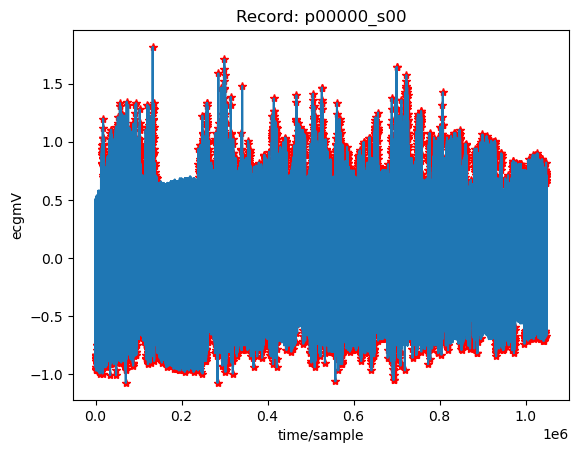

In [4]:
import wfdb
patient_id=0
segment_id=0
filename = f'{output_folder}/p00/p00000/p00000_s00'
rec = wfdb.rdrecord(filename)
ann = wfdb.rdann(filename, "atr")
wfdb.plot_wfdb(rec, ann)

In [5]:
import wfdb

data_path = 'C:/Users/andre/1JUPYTER/IC/ecg_data/2_European STT/data'
filename = f'{output_folder}/p00/p00000/p00000_s00'
rec = wfdb.rdrecord(filename)
ann = wfdb.rdann(filename, "atr")
# wfdb.plot_wfdb(rec, ann, plot_sym=True, figsize=(15,4))

from collections import Counter
counts = Counter(ann.symbol)

# Print unique values and their counts
for value, count in counts.items():
    print(f"{value}: {count}")


N: 6641
+: 38
Q: 244


In [ ]:
import os
import numpy as np
from wfdb.io import rdrecord, rdann

window_duration_seconds = 0.5  # Window duration in seconds

filename = f'{output_folder}/p00/'

# Load the ECG record
for p_folder in range(1):  # p00 to p10
    p_folder_str = f"p{p_folder:02d}"
    for p_subfolder in range(1000):  # p0000 to p0999
        p_subfolder_str = f"p{p_subfolder:05d}"
        record_num = f'{p_folder_str}/{p_subfolder_str}/{p_subfolder_str}'
        annotation_path = os.path.join(record_path, f"{record_num}.hea")

        try:
            # Load annotations
            annotation = rdann(annotation_path, extension='atr')
            ann_sample = annotation.sample
            ann_symbol = annotation.symbol

            # Load ECG signal
            record = rdrecord(annotation_path)
            fs = record.fs  # Sampling frequency
            ecg_signal = record.p_signal[:, 0]

            # Calculate window size based on window duration and sampling frequency
            window_size = int(window_duration_seconds * fs)

            # Iterate over each heartbeat and segment it
            for j, (peak, beat_type) in enumerate(zip(ann_sample[2:-1], ann_symbol[2:-1])):
                if beat_type in ["|", "\""]:  # Ignore | and " beat_type
                    continue

                # Centralize the segment around the peak
                start = peak - window_size // 2
                end = peak + window_size // 2

                # Ensure the segment boundaries are within the signal range
                start = max(0, start)
                end = min(len(ecg_signal), end)

                segment = ecg_signal[start:end]

                # Check if the segment directory exists
                segment_dir = os.path.join(record_path, 'segmented_data', beat_type, record_num)
                if not os.path.exists(segment_dir):
                    os.makedirs(segment_dir)

                # Check if the segment file already exists
                file_name = f"{record_num}_segment_{j:05d}_{beat_type}.csv"
                file_path = os.path.join(segment_dir, file_name)
                if not os.path.exists(file_path):
                    # Save the segment as a new file in the segmented folder
                    np.savetxt(file_path, segment, delimiter=",")
                    print(f"Segment {j} ({beat_type}) as {file_name}")
                else:
                    print(f"SKIPPING - Segment {j} ({beat_type}) as it already exists.")
        except FileNotFoundError:
            print(f"FileNotFoundError: {annotation_path} not found. Skipping...")


In [ ]:
import os
import numpy as np
import pandas as pd
import wfdb

window_duration_seconds = 0.5  # Window duration in seconds

record_path = 'C:\\Users\\andre\\1JUPYTER\\IC\\ecg_data\\2_European STT\\data'
beat_types = ['N', '+', 'V', 'F', '~', 'T', 'S', 'Q', 'J', 'n', 'a']

# Create a list to hold dictionaries of annotations for each record
data_list = []

# Load the ECG record
for i in range(103, 1035):
    record_num = f'e{i:04d}'
    annotation_path = os.path.join(record_path, record_num)

    try:
        # Load annotations
        annotation = wfdb.rdann(annotation_path, extension='atr')
        ann_symbol = annotation.symbol

        # Create a dictionary to hold the annotations for this record
        record_annotations = {'pacient': record_num}

        # Count the occurrences of each annotation for this record
        for beat_type in beat_types:
            record_annotations[beat_type] = ann_symbol[2:-1].count(beat_type)

        # Append the record's annotations to the list
        data_list.append(record_annotations)

    except FileNotFoundError:
        print(f"FileNotFoundError: {record_num} not found. Skipping...")

# Convert the list of dictionaries into a DataFrame
data = pd.DataFrame(data_list)

data